<a href="https://colab.research.google.com/github/shubham777/US-Stock-Market-Analysis-using-Network-Graphs/blob/main/Analysis_v1.0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import yfinance as yf
import numpy as np
import networkx as nx
import community.community_louvain as community
from scipy.stats import linregress

In [ ]:
!pip install yahoo_fin
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller
import itertools
from yahoo_fin import stock_info as si

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.1/81.1 kB 6.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.5/50.5 kB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.4/83.4 kB 7.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.5/106.5 kB 8.9 MB/s eta 0:00:00
  Created wheel for bs4: filename=bs4-0.0.1-py3-none-any.whl size=1270 sha256=537dfd20bf2a2f5e5fe587902e6f55078fad9150a38eac6dc776767093e69361
  Stored in directory: /root/.cache/pip/wheels/73/2b/cb/099980278a0c9a3e57ff1a89875ec07bfa0b6fcbebb9a8cad3
  Created wheel for parse: filename=parse-1.19.0-py3-none-any.whl size=24589 sha256=94fabd0d6e510af2c5c4041797621f0abe39ffba464e15924b4725e3a6610c55
  Stored in directory: /root/.cache/pip/wheels/d6/9c/58/ee

# <u>**Data Collection**<u>

In [ ]:
table=pd.read_html('https://en.wikipedia.org/wiki/List_of_S%26P_500_companies')
df = table[0]
companies=[]
for i in range(len(df['Symbol'])):
  companies.append(df['Symbol'][i])

In [ ]:
data = {}

for ticker in companies:
    # Create a Ticker object for the current ticker
    ticker_obj = yf.Ticker(ticker)

    # Get the industry sector of the current ticker
    if 'sector' in ticker_obj.info:
        sector = ticker_obj.info['sector']
    else:
        sector = 'N/A'

    # Get historical data for the current ticker
    ticker_data = ticker_obj.history(start="2018-01-01", end="2022-12-31")

    # Add a 'Symbol' column with the current ticker symbol
    ticker_data['Symbol'] = ticker

    # Add a 'Sector' column with the industry sector of the current ticker
    ticker_data['Sector'] = sector

    # Store the historical data for the current ticker in the dictionary
    data[ticker] = ticker_data

# Concatenate the historical data for all tickers into a single DataFrame
df = pd.concat(data.values(), keys=data.keys())


Got error from yahoo api for ticker BRK.B, Error: {'code': 'Not Found', 'description': 'No data found, symbol may be delisted'}
- BRK.B: No timezone found, symbol may be delisted
BF.B: No data found for this date range, symbol may be delisted


In [ ]:
col_p = 'close'

concatenated_df = pd.concat(data.values(), keys=data.keys())
concatenated_df.reset_index(inplace=True)
concatenated_df.rename(columns={'level_0': 'ticker', 'Date': 'date', 'Open': 'open', 'High': 'high', 'Low': 'low', 'Close': 'close', 'Volume': 'vol'}, inplace=True)

# Create the df_price DataFrame
df_price = concatenated_df[['ticker', 'date', col_p]]
df_price = df_price.drop_duplicates(subset=['date', 'ticker'], keep='last')
df_price['date'] = pd.to_datetime(df_price['date'], format='%Y-%m-%d')
df_price.set_index(['date', 'ticker'], inplace=True)
df_price = df_price.unstack()[col_p]
df_price.reset_index(inplace=True)
df_price.fillna(method='bfill', inplace=True)
df_price.fillna(method='ffill', inplace=True)

# <u>**Detrend data - Compute log returns**<u>

Among the available techniques in the current literature, we have opted for Time-lag correlations of price changes within a specific timeframe. However, a significant challenge in calculating correlations on stock prices is that their values are dynamic time series and exhibit inherent trends, which could result in false correlations if the data is not correctly normalized.

It can be represented in written form as:

$[P_0,P_1,P_2,\dots,P_N]$ or $[P_0,P_0+R_1,P_0+R_1+R_2,\dots,P_0+R_1+\dots+R_N]$, where $R_i=P_i-P_{i-1}$

While log returns can be calculated over various time periods such as 7, 30, 60, or 100 days, for the sake of simplicity, we limited the return window to one day.


In [ ]:
import scipy.signal
t = 1
for key in df_price.columns:
    if key not in companies:
        continue
    try:
        df_price[key] = np.log(df_price[key]) - np.log(df_price[key].shift(t))
    except:
        print (key)
df_price.set_index('date',inplace=True)

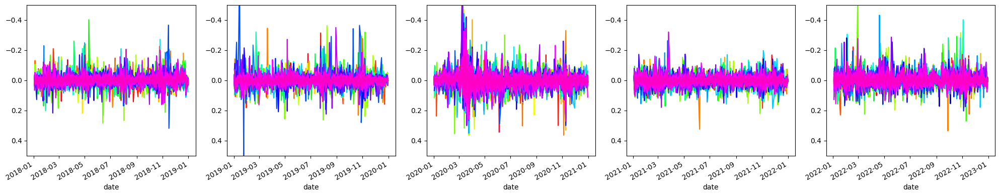

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
import random as rn
NUM_COLORS = len(companies)
cm = plt.get_cmap('gist_rainbow')
colors = [cm(i/NUM_COLORS) for i in range(NUM_COLORS)]
rn.seed = len(companies)  # for choosing random colors
fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(20, 4))
y = 2018

for col in ax:
    yfs = str(y) + '0101'
    yfe = str(y) + '1231'
    n = 0
    col.set_ylim([0.5, -0.5])
    for i in df_price.columns:
        df_price.loc[yfs:yfe][i].plot(ax=col, color=colors[n])
        n = n + 1
    y = y + 1

plt.tight_layout()
plt.show()

# <u>**Compute Correlation matrix for multiple windows**</u>

In this step, we calculate the Pearson correlation between the log returns of the stocks. To uncover the dynamic characteristics of the networks, we divide the data into windows with a specified width (T). The window width corresponds to the number of daily returns used to compute the correlation between stocks. The method of dividing time windows to construct asset graphs can be found in the literature on asset trees and asset graphs in financial markets. To identify the optimal window length, we calculated the mean correlation for window values of 21, 42, 63, 84, and 105, and then plotted the variations in correlation.

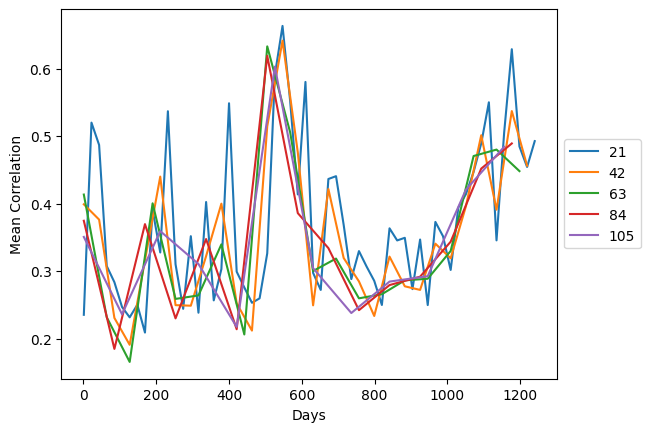

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
corr_dict = {}
T = 1
for w in range(21,126,21):
    x = []
    y = []
    W = w
    for i in range(t,len(df_price),W):
            dkey = i
            corr_dict[dkey]=df_price.iloc[i:(i+W)].corr(method='pearson')
            corr_dict[dkey].fillna(0,inplace=True)
            x.append(dkey)
            y.append(np.mean([abs(j) for j in corr_dict[dkey].values.flatten().tolist()]))
    plt.plot(x,y)
    plt.xlabel('Days')
    plt.ylabel('Mean Correlation')
    plt.legend(list(range(21,126,21)), loc='center left', bbox_to_anchor=(1, 0.5),ncol=1)
plt.show()
W = 63
corr_dict = {}
for i in range(t,len(df_price),W):
      dkey = i
      corr_dict[dkey]=df_price.iloc[i:(i+W)].corr(method='pearson')
      corr_dict[dkey].fillna(0,inplace=True)

# <u>**Build network: WTA - Winner-Take-All method**</u>

In the literature, [A Network Perspective of the Stock Market](https://www.researchgate.net/publication/222825530_A_network_perspective_of_the_stock_market) discusses the winner-take-all method, where a network is constructed based on the correlation matrix if the correlation index value is above a certain threshold.

Determining the ideal threshold value is crucial. Since one of the main objectives of the study is to examine whether stocks exhibit group behavior, we aimed to select a threshold that maximizes modularity. However, we were also careful not to overfit the data, as doing so might cause us to lose insight into the underlying market dynamics.

In the following step, we built networks using different thresholds ranging from 0.6 to 0.99 for the identified windows. We then chose the threshold value corresponding to the maximum modularity. Upon analyzing the results, we observed that most networks exhibited high modularity for threshold values between 0.75 and 0.85. There were certain windows where the best modularity threshold exceeded 0.9; however, the number of edges at this threshold was minimal. In such cases, we set the threshold to 0.8 and constructed the network. We treated both positive and negative correlations equally, considering their absolute values.

In [ ]:
def get_modularity(y,threshold):
    df_price_corr = corr_dict[y]
    elist = []
    outdict=df_price_corr.to_dict()
    for i in outdict.keys():
        for j in outdict[i].keys():    
            if abs(outdict[i][j]) > threshold :
                if i == j :
                    continue
                if i < j:
                    elist.append([i,j,dict(weight=abs(outdict[i][j]),start=y,end=y+W)])
                    #elist.append([i,j,dict(start=y,end=y+1)])
                else:
                    None
    #print (len(elist))
    G=nx.Graph()
    G.add_edges_from(elist)
    #print (nx.info(G))
    partition = community.best_partition(G)
    try:
        m = community.modularity(partition, G)
    except:
        m = 0 
    return m
# This will be our list of fractions to run the simulation over
fractions = np.linspace(0.6, 0.99, 20)
M_list = {}
for y in corr_dict.keys():
    M_list[y] = [ get_modularity(y, frac)  for frac in fractions ]

This plot shows the relationship between the threshold value and the computed markdown across different windows.

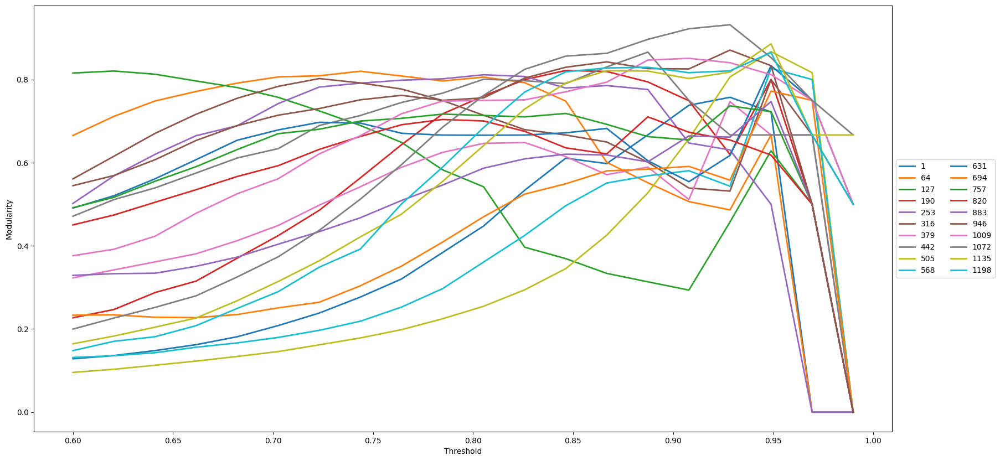

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.figure(figsize=(20,10))
for y in corr_dict.keys():
    plt.plot(fractions, M_list[y], lw=2)
plt.legend(list(M_list.keys()), loc='center left', bbox_to_anchor=(1, 0.5),ncol=2)
plt.xlabel('Threshold')
plt.ylabel('Modularity')
plt.show()

In [ ]:
# Pick value of threshold for each Window (T)
T_val = {}
for y in M_list.keys():
    val, idx = max((val, idx) for (idx, val) in enumerate(M_list[y]))
    if fractions[idx] > 0.8:
        T_val[y] = 0.8
    else:
        T_val[y] = fractions[idx]

In [ ]:
# Create Edge List
elist_dict={}
for y in corr_dict.keys():
    df_price_corr = corr_dict[y]
    threshold = T_val[y]
    elist = []
    outdict=df_price_corr.to_dict()
    for i in outdict.keys():
        for j in outdict[i].keys():
            if abs(outdict[i][j]) > threshold :
                if i == j :
                    continue
                if i < j:
                    elist.append([i,j,dict(weight=1,start=y,end=y+W-1)])
                else:
                    None
    elist_dict[y] = elist

In [ ]:
G_dict = {}
for y in elist_dict.keys():
    G = nx.Graph()
    elist = elist_dict[y]
    G.add_edges_from(elist)
    values = df.set_index('Symbol').to_dict(orient='dict')['Sector']
    for node, value in values.items():
        try:
            G.nodes[node]['Sector'] = value
        except:
            None
    partition = community.best_partition(G)
    
    deg_cent = dict((k, float(v)) for k, v in nx.degree_centrality(G).items())
    close_cent = dict((k, float(v)) for k, v in nx.closeness_centrality(G).items())  
    betw_cent = dict((k, float(v)) for k, v in nx.betweenness_centrality(G).items()) 
    
    nx.set_node_attributes(G, partition, "community")
    nx.set_node_attributes(G, deg_cent, "degreecent")
    nx.set_node_attributes(G, close_cent, "closeness")
    nx.set_node_attributes(G, betw_cent, "betweenness")
    nx.set_node_attributes(G, y, 'start')
    nx.set_node_attributes(G, y+W-1, 'end')
    
    T = G
    G_dict[y] = T


In [ ]:
import pandas as pd

df_list = []
for k in G_dict.keys():
    G = G_dict[k]
    a = dict(G.nodes(data=True))
    df_list.append(pd.DataFrame.from_dict(a, orient='index').reset_index())
attrib_df = pd.concat(df_list)
attrib_df.fillna(0, inplace=True)
attrib_df1 = attrib_df.merge(df, left_on='index', right_on='Symbol')
attrib_df = attrib_df1[['index', 'Sector_x', 'community', 'degreecent', 'closeness','betweenness', 'start', 'end']]
attrib_df.columns = ['ticker', 'Sector', 'Betweeness', 'Closeness', 'Community', 'DegreeCent', 'start', 'Name']


In [ ]:
G_val_dict = {}
for Y in G_dict.keys():
    G_val = {}
    G= G_dict[Y]
    G_val['nodes'] =  int(nx.number_of_nodes(G))
    G_val['edges'] =  int(nx.number_of_edges(G))
    #G_val['AvgDegree'] =  nx.average_degree(G)
    G_val['AvgClustering'] = nx.average_clustering(G)
    try:
        G_val['AvgShortestPathLength'] = nx.average_shortest_path_length(G)
    except:
        G_val['AvgShortestPathLength'] = 99999
    try:
        G_val['Diameter'] = nx.diameter(G)
    except:
        G_val['Diameter'] = 99999
    degs = {}
    for n in G.nodes() :
        deg = G.degree(n)
        if deg not in degs.keys() :
            degs[deg] = 0
        degs[deg] += 1
    items = sorted(degs.items())
    x= [k for (k , v ) in items ]
    y= [ v for (k ,v ) in items ]
    xlog= np.array([np.log(k) for (k , v ) in items ])
    ylog= np.array([np.log(v) for (k ,v ) in items ])
    slope,intercept,rvalue,pvalue,stderr=linregress(xlog,ylog)
    G_val['Slope'] = slope
    G_val['No of Communities'] = attrib_df.groupby(by=['start'])['Community'].nunique().loc[Y]
    G_val_dict[Y] = G_val
Gvaldf=pd.DataFrame(G_val_dict).T

The table below presents the network properties for the networks generated using the Winner-Take-All Method across multiple time periods.

In [ ]:
pd.options.display.max_rows = 999
Gvaldf

,nodes,edges,AvgClustering,AvgShortestPathLength,Diameter,Slope,No of Communities
1,231.0,1271.0,0.481281,99999.0,99999.0,-0.969620,154.0
64,224.0,447.0,0.409174,99999.0,99999.0,-1.306606,104.0
127,329.0,1141.0,0.485862,99999.0,99999.0,-0.970678,214.0
190,278.0,1044.0,0.501907,99999.0,99999.0,-1.151724,173.0
253,134.0,238.0,0.330953,99999.0,99999.0,-1.161401,57.0
316,279.0,987.0,0.508934,99999.0,99999.0,-1.095532,154.0
379,179.0,471.0,0.390077,99999.0,99999.0,-1.149633,111.0
442,93.0,121.0,0.375947,99999.0,99999.0,-1.488850,34.0
505,467.0,15867.0,0.634226,99999.0,99999.0,-0.458576,328.0
568,351.0,4096.0,0.568258,99999.0,99999.0,-0.779200,266.0


# <u>**Degree distribution and Scale Free Properties**</u>

We created a histogram to display the degree distribution and also plotted the degree distribution on a log-log scale. By fitting a regression line, we obtained the power law exponent from its slope. The plots reveal that the network exhibits scale-free properties in most of the windows. The scale-free nature is more apparent in the networks generated using the Minimum Spanning Tree Method.

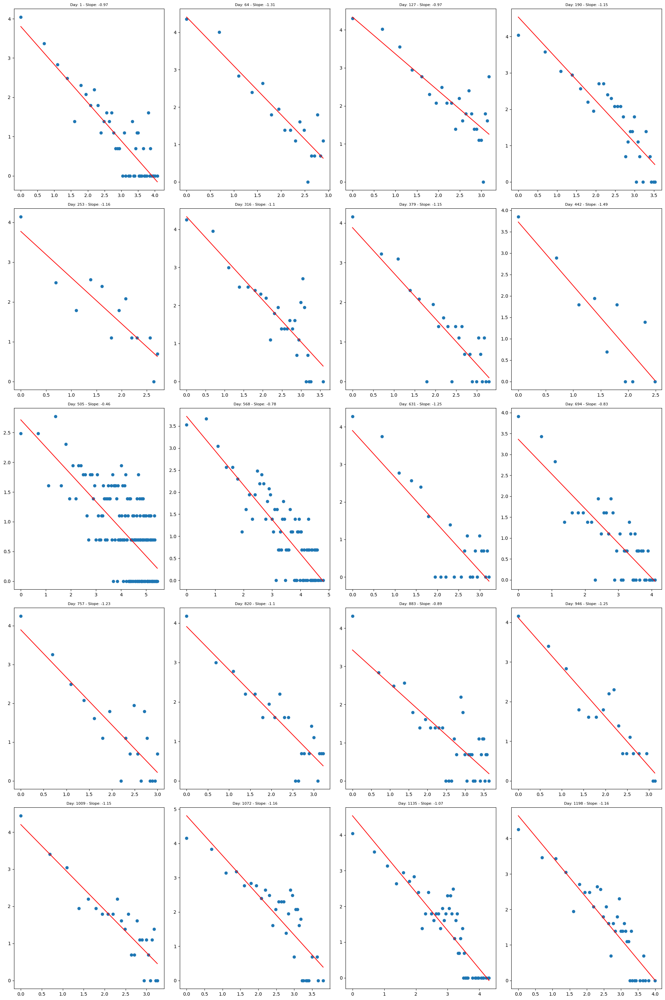

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress

%matplotlib inline

valid_keys = [key for key in G_dict.keys() if key <= 1198]

# Calculate the number of rows and columns based on the number of valid keys
nrows = int(np.ceil(len(valid_keys) / 4))
ncols = 4

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 30))

Y_index = 0

for row in ax:
    for col in row:
        if Y_index < len(valid_keys):
            Y = valid_keys[Y_index]
            degs = {}
            for n in G_dict[Y].nodes():
                deg = G_dict[Y].degree(n)
                if deg not in degs.keys():
                    degs[deg] = 0
                degs[deg] += 1
            items = sorted(degs.items())
            x = [k for (k, v) in items]
            y = [v for (k, v) in items]
            xlog = np.array([np.log(k) for (k, v) in items])
            ylog = np.array([np.log(v) for (k, v) in items])
            col.scatter(xlog, ylog)
            slope, intercept, rvalue, pvalue, stderr = linregress(xlog, ylog)
            col.plot(xlog, (slope * xlog + intercept), color='red')
            col.set_title("Day: " + str(Y) + " - Slope: " + str(round(slope, 2)), fontsize=8)
            Y_index += 1
        else:
            col.axis('off')  # Hide empty subplots

plt.tight_layout()
plt.show()


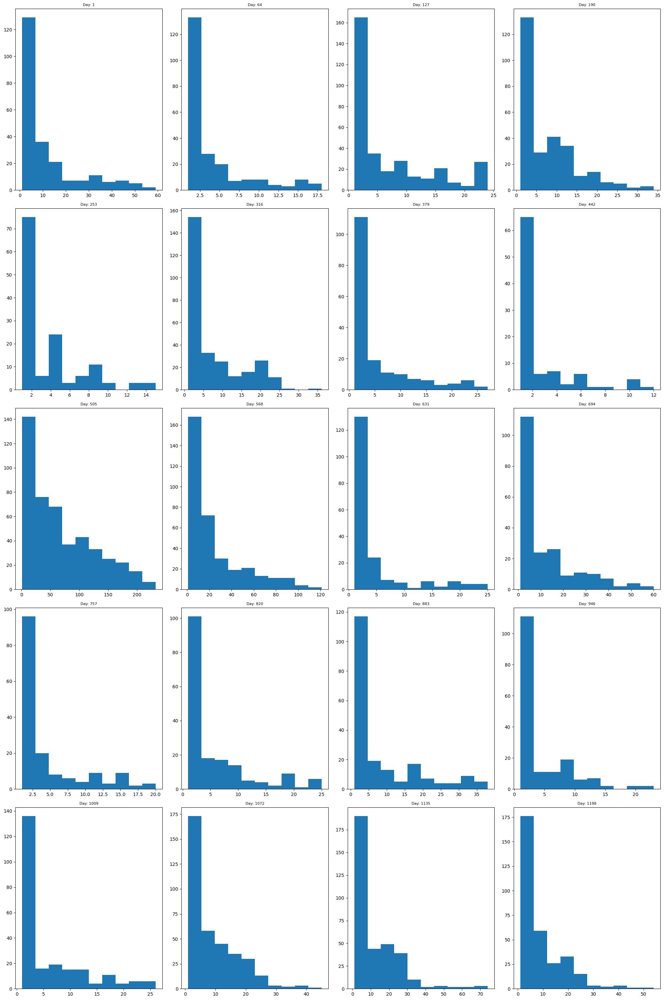

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx

valid_keys = [key for key in G_dict.keys() if key <= 1198]

# Calculate the number of rows and columns based on the number of valid keys
nrows = int(np.ceil(len(valid_keys) / 4))
ncols = 4

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 30))

Y_index = 0

for row in ax:
    for col in row:
        if Y_index < len(valid_keys):
            y = valid_keys[Y_index]
            deg_dist = [v for k, v in dict(nx.degree(G_dict[y])).items()]  # Convert DegreeView to dictionary
            deg_dist.sort(reverse=True)
            if deg_dist:  # Check if degree distribution is not empty
                pdf, bins, patch = col.hist(deg_dist, bins=10)
                col.set_title("Day: " + str(y), fontsize=8)
            Y_index += 1
        else:
            col.axis('off')  # Hide empty subplots

plt.tight_layout()
plt.show()


# <u>**Average degree of the network over time**</u>

We analyzed the change in average degree over time. For networks generated using the Winner-Take-All method, we observed significant variations over time, reflecting the dynamic nature of the stock market.

In [ ]:
for Y in G_dict.keys():
    G = G_dict[Y]
    num_nodes = G.number_of_nodes()
    num_edges = G.number_of_edges()
    avg_degree = (2 * num_edges) / num_nodes if num_nodes > 0 else 0
    G.graph['AvgDegree'] = avg_degree  # Assign the avg_degree to the graph attribute

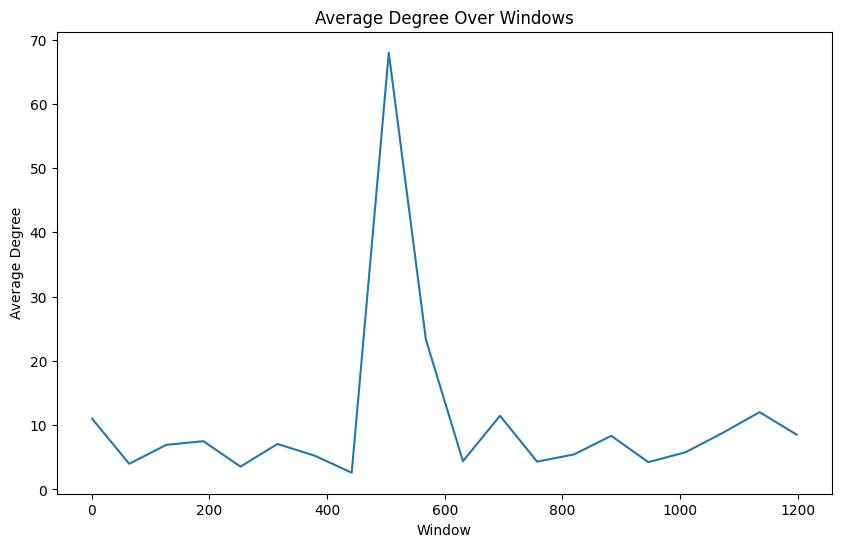

In [ ]:
# Prepare data for plotting
x_values = list(G_dict.keys())
y_values = [G_dict[Y].graph['AvgDegree'] for Y in x_values]

# Plot the data
plt.figure(figsize=(10, 6))
plt.plot(x_values, y_values)
plt.xlabel('Window')
plt.ylabel('Average Degree')
plt.title('Average Degree Over Windows')
plt.show()

# <u>**High degree stocks in the network**</u>

We examined high-degree stocks in the network across different windows to identify significant stocks with a high influence or those that serve as good indicators of overall stock market movement. The results are presented below. As can be observed, stocks from the financial sector consistently exhibit the highest degree in numerous windows. This raises the question of whether there is a discernible pattern at play.

In [ ]:
result = attrib_df.sort_values(['start', 'DegreeCent'], ascending=False).groupby(['start']).head(3)[['start', 'ticker', 'Name', 'DegreeCent', 'Sector']]
print(result)

         start ticker  Name  DegreeCent              Sector
119605    1198    ITW  1260    0.118079         Industrials
119606    1198    ITW  1260    0.118079         Industrials
119607    1198    ITW  1260    0.118079         Industrials
3165126   1135    TXT  1197    0.065813         Industrials
3165127   1135    TXT  1197    0.065813         Industrials
3165128   1135    TXT  1197    0.065813         Industrials
1465476   1072    AMP  1134    0.098643  Financial Services
1465477   1072    AMP  1134    0.098643  Financial Services
1465478   1072    AMP  1134    0.098643  Financial Services
39029     1009    APH  1071    0.017101          Technology
39030     1009    APH  1071    0.017101          Technology
39031     1009    APH  1071    0.017101          Technology
1619074    946    PRU  1008    0.007836  Financial Services
1619075    946    PRU  1008    0.007836  Financial Services
1619076    946    PRU  1008    0.007836  Financial Services
3800921    883    MPC   945    0.068227 

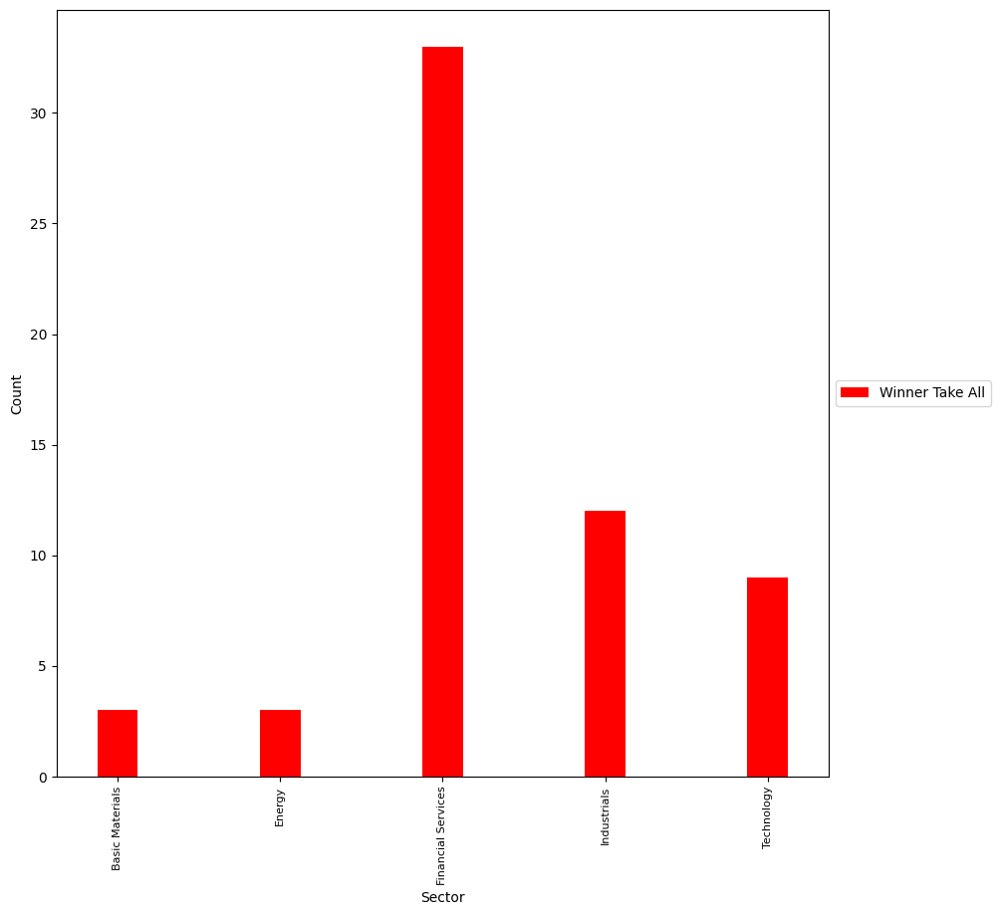

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

df1 = attrib_df.sort_values(['start', 'DegreeCent'], ascending=False).groupby(['start']).head(3).groupby(['Sector']).count()['ticker']

fig = plt.figure(figsize=(10, 10))
df1.plot(kind='bar', color='red', width=0.25)
plt.xticks(rotation=90, fontsize=8)
plt.ylabel('Count')
plt.legend(['Winner Take All'], loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
plt.show()

# <u>**Stocks With High Betweenness Centrality**</u>

In [ ]:
attrib_df.sort_values(['start','Betweeness'],ascending=False).groupby(['start']).head(3)[['start','ticker','Name','Betweeness','Sector']]

,start,ticker,Name,Betweeness,Sector
5545895,1198,EW,1260,32,Healthcare
5545896,1198,EW,1260,32,Healthcare
5545897,1198,EW,1260,32,Healthcare
4620530,1135,LVS,1197,26,Consumer Cyclical
4620531,1135,LVS,1197,26,Consumer Cyclical
4620532,1135,LVS,1197,26,Consumer Cyclical
3095881,1072,CSX,1134,28,Industrials
3095882,1072,CSX,1134,28,Industrials
3095883,1072,CSX,1134,28,Industrials
1950191,1009,HD,1071,42,Consumer Cyclical


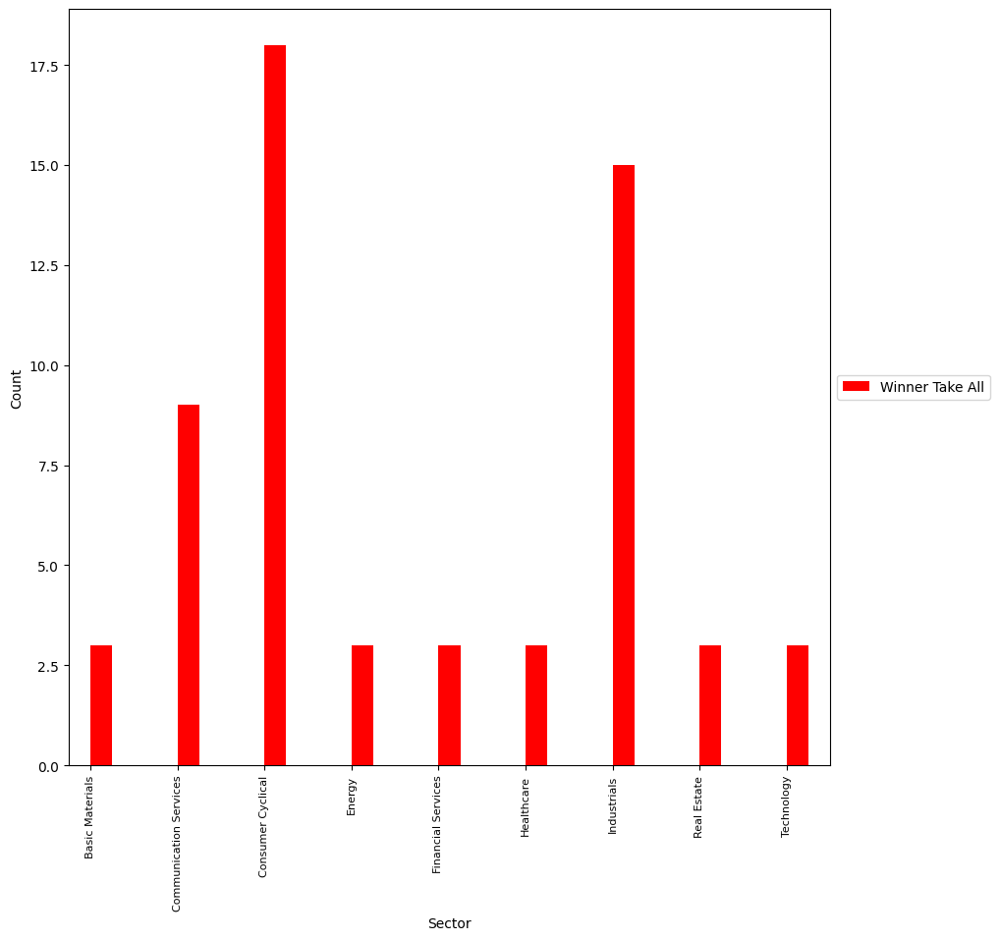

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

df1 = attrib_df.sort_values(['start', 'Betweeness'], ascending=False).groupby(['start']).head(3).groupby(['Sector']).count()['ticker']
df3 = df1.to_frame()
df3.columns = ['t1']

fig = plt.figure(figsize=(10, 10))
df3['t1'].plot(kind='bar', color='red', position=0, width=0.25)
plt.xticks(rotation=90, fontsize=8)
plt.ylabel('Count')
plt.legend(['Winner Take All'], loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
plt.show()

# <u>**Communities detected over time**</u>

We examined the number of communities detected across various periods. The fluctuations in the number of communities highlight the dynamic nature of the market, where new stock communities are formed in each window. These communities can either persist or cease to exist in subsequent periods.

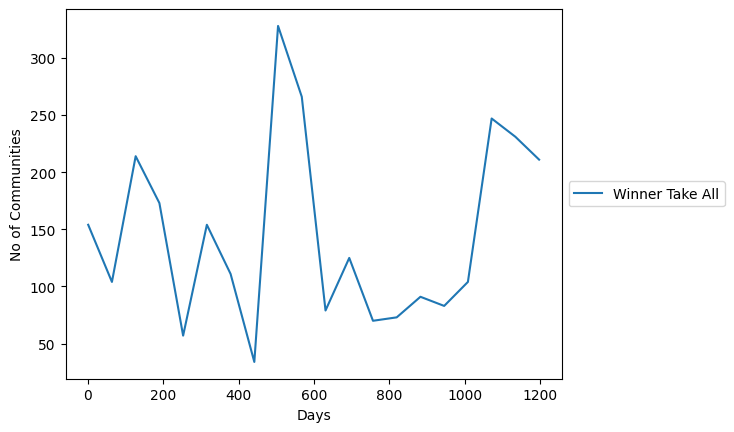

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

cdf = attrib_df.groupby(by=['start'])['Community'].nunique()
cdf.plot()

plt.legend(['Winner Take All'], loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
plt.xlabel('Days')
plt.ylabel('No of Communities')
plt.show()

# <u>**Jaccard Similarity of Communities Detected with Sector Code**</u>

As part of our project, one of the main objectives was to investigate whether there is any correlation between the networks created based on stock prices and the Standard Industry Classification (SIC) codes of these stocks. Specifically, we wanted to determine whether Financial, Industrial, and IT stocks trade in groups. To assess the similarity between the detected communities and the SIC codes of the SP500 stocks, we calculated the Jaccard similarity coefficient of these communities in each time window with the stock list grouped by industry code.

We transformed the stock list into the detected communities and the stock list according to the SIC code into a binary matrix. In this matrix, the presence of a stock in a community or group is represented by 1, while the absence is represented by 0.

The Jaccard coefficient is a useful measure of the overlap between two objects, A and B, with n binary attributes each. Each attribute of A and B can only take on the values of 0 or 1. The total number of each combination of attributes for both A and B can be specified as follows:

- M_11 represents the total number of attributes where A and B both have a value of 1.
- M_01 represents the total number of attributes where the attribute of A is 0 and the attribute of B is 1.
- M_10 represents the total number of attributes where the attribute of A is 1 and the attribute of B is 0.
- M_00 represents the total number of attributes where A and B both have a value of 0.

Each attribute can be classified into one of four categories, which means that the sum of M_11, M_01, M_10, and M_00 must be equal to n.

The Jaccard similarity coefficient, J, is calculated as follows:

If a community has a Jaccard coefficient greater than 0.25 with the group of stocks classified by the SIC code, we classified that community as belonging to that particular SIC code. The plot below presents an interesting finding.

As we can see from the visualization, some sectors are highly correlated or connected, and the detected communities clearly indicate that these stocks trade in groups over different periods.

In [ ]:
cmatrix = attrib_df.groupby(by=['start','Community','ticker'])['ticker'].count().unstack()
cmatrix.fillna(0,inplace=True)
smatrix = attrib_df.groupby(by=['Sector','ticker'])['ticker'].count().unstack()
smatrix.fillna(0,inplace=True)
smatrix[smatrix != 0] = 1
csmatrix = pd.concat([smatrix,cmatrix])
jval = {}

for idxs, rows in smatrix.iterrows():
    xlist = []
    ylist = []
    for idxc, rowc in cmatrix.iterrows():
        x = set(rows[rows != 0].index)
        y = set(rowc[rowc != 0].index)
        intersection = len(x.intersection(y))
        union = len(x.union(y))
        
        if union != 0:
            jc = intersection / union
            xlist.append(idxc[0])
            ylist.append(jc)
        else:
            jc = 0
    jval[idxs] = [xlist, ylist]

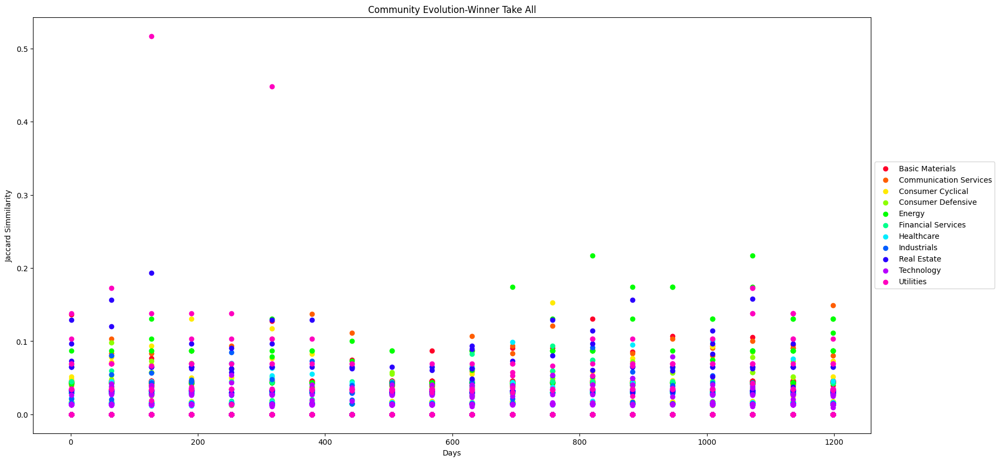

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.figure(figsize=(20,10))
cm = plt.get_cmap('gist_rainbow')
NUM_COLORS = 11
colors = [cm(i) for i in np.linspace(0,1,NUM_COLORS)]
color_dict=dict(zip(list(jval.keys()), colors))
for key in jval:
    x = jval[key][0]
    y = jval[key][1]
    plt.scatter(x,y,color=color_dict[key],label=key)
    
#plt.legend(list(jval.keys()), loc='center left', bbox_to_anchor=(1, 0.5))
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel('Days')
plt.ylabel('Jaccard Simmilarity')
plt.title('Community Evolution-Winner Take All')
plt.show()

# <u>**Visuvalize the network and the evolution**</u>

---



In [ ]:
# Constructing a graph
import networkx as nx
M=nx.MultiGraph()
for y in G_dict.keys():
    M.add_nodes_from(G_dict[y].nodes(data=True))
    M.add_edges_from(G_dict[y].edges(data=True))
nx.write_gexf(M,'data/price-sp500.gexf')

In [ ]:
import xml.etree.ElementTree as ET
tree = ET.parse('data/price-sp500.gexf')
root = tree.getroot()
for element in root.iter("{http://www.gexf.net/1.1draft}node"):
    #print (element.attrib)
    noden = element.attrib['id']
    for child in element:
        for i in range(len(child)):
            child.remove(child[0])
        for y in G_dict.keys():
            T = G_dict[y]
            n = 0
            try:
                for att in T.node[noden]:
                    new = ET.Element("{http://www.gexf.net/1.1draft}attvalue")
                    new.set('for',str(n))
                    new.set('value',str(T.node[noden][att]))
                    new.set('start',str(y))
                    new.set('end',str(y+W-1))
                    child.append(new)
                    #print (T.node[noden][att])
                    n = n + 1
            except:
                continue
for element in root.iter("{http://www.gexf.net/1.1draft}edge"):
    #print (element.attrib)
    noden = element.attrib['id']
    for child in element:
        for i in range(len(child)):
            child[i].set('start',str(element.attrib['start']))
            child[i].set('end',str(element.attrib['end']))
tree.write('data/price-sp500-o.gexf')


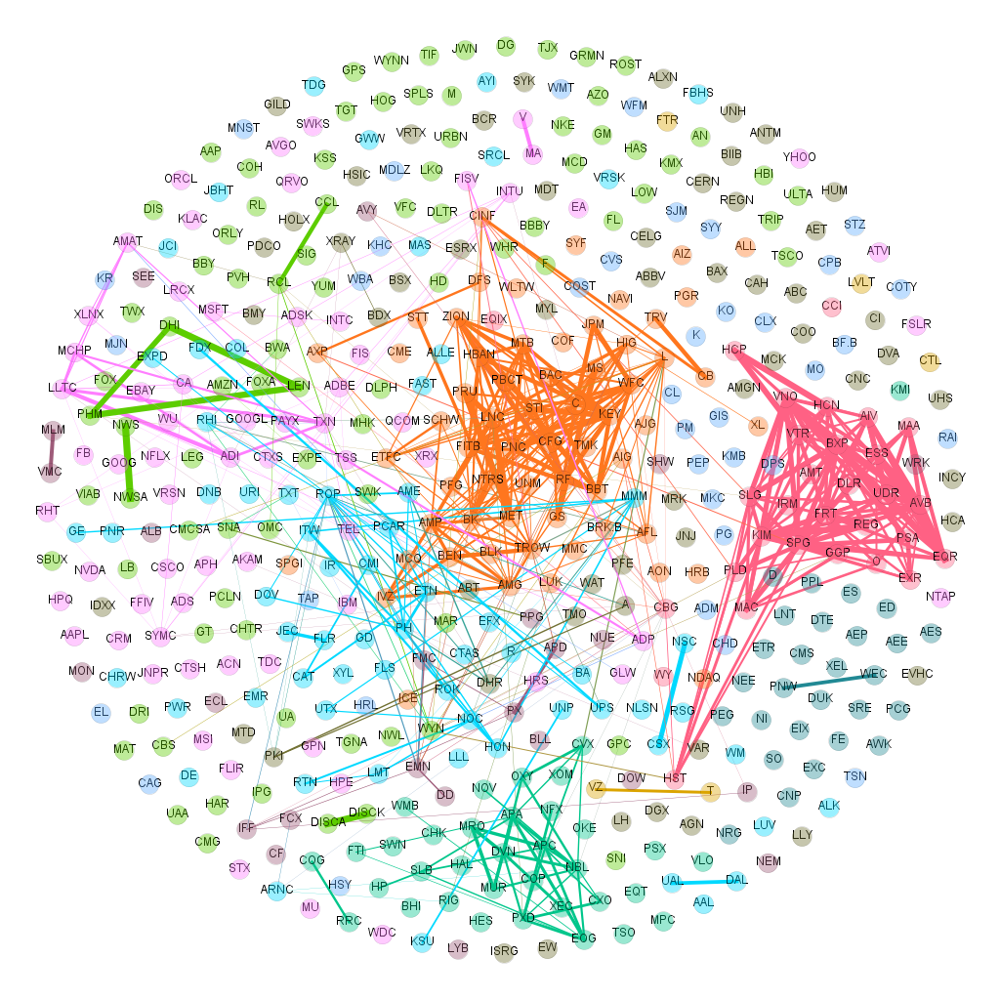

In [ ]:
from IPython.display import Image
Image(filename='data/WTA-period-1702.png') 

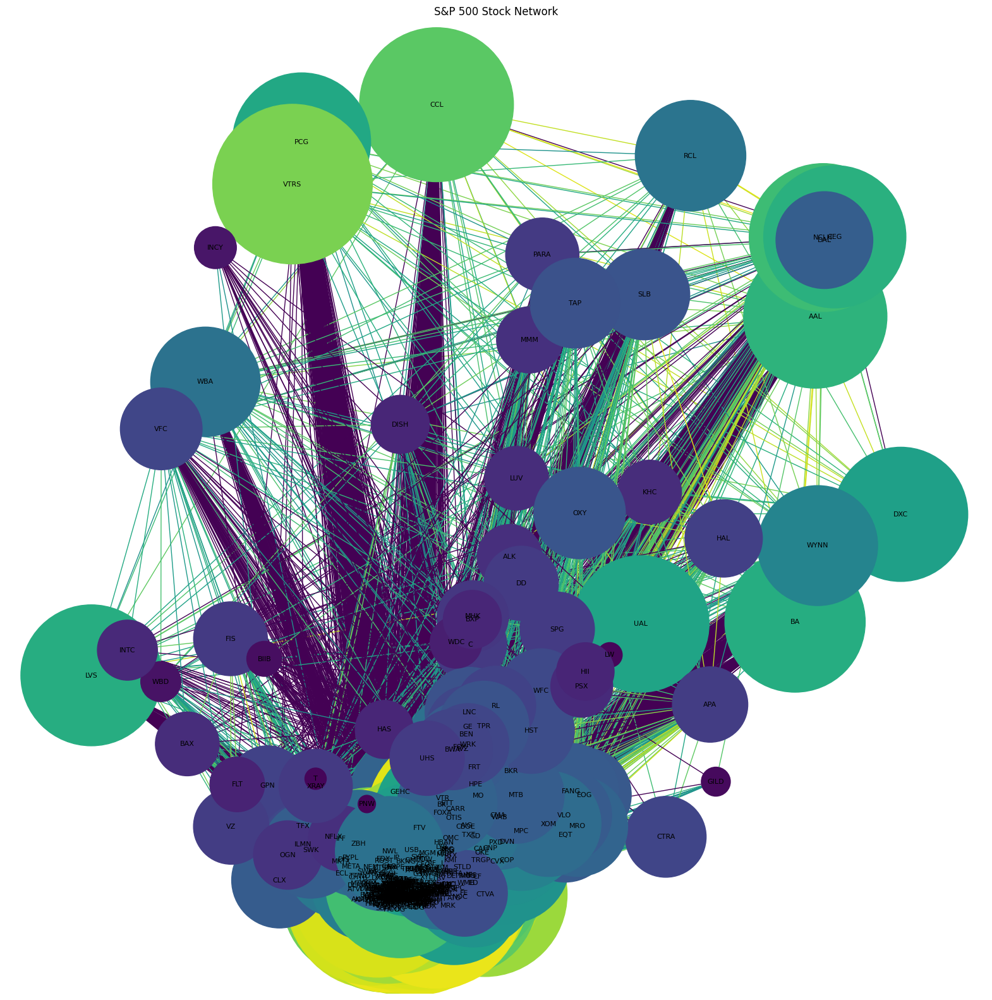

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import yfinance as yf

# Calculate the correlation matrix
df_close = df.pivot_table(index='Date', columns='Symbol', values='Close')
correlation_matrix = df_close.corr()

# Create an edge list from the correlation matrix
threshold = 0.5  # Adjust the threshold to filter out weak correlations
edges = []
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], correlation_matrix.iloc[i, j]))

# Create a graph object and add edges
G = nx.Graph()
G.add_weighted_edges_from(edges)

# Set up the layout
pos = nx.spring_layout(G, seed=42)

# Set up node and edge colors
node_colors = [plt.cm.viridis(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes]
edge_colors = [plt.cm.viridis(edge_data['weight']) for _, _, edge_data in G.edges(data=True)]

# Set up node sizes (optional)
node_sizes = [G.degree[node] * 100 for node in G.nodes]

# Draw the graph
plt.figure(figsize=(20, 20))
nx.draw_networkx(G, pos, node_size=node_sizes, node_color=node_colors, edge_color=edge_colors, with_labels=True, font_size=8)

# Set the plot title and display it
plt.title('S&P 500 Stock Network')
plt.axis('off')
plt.show()


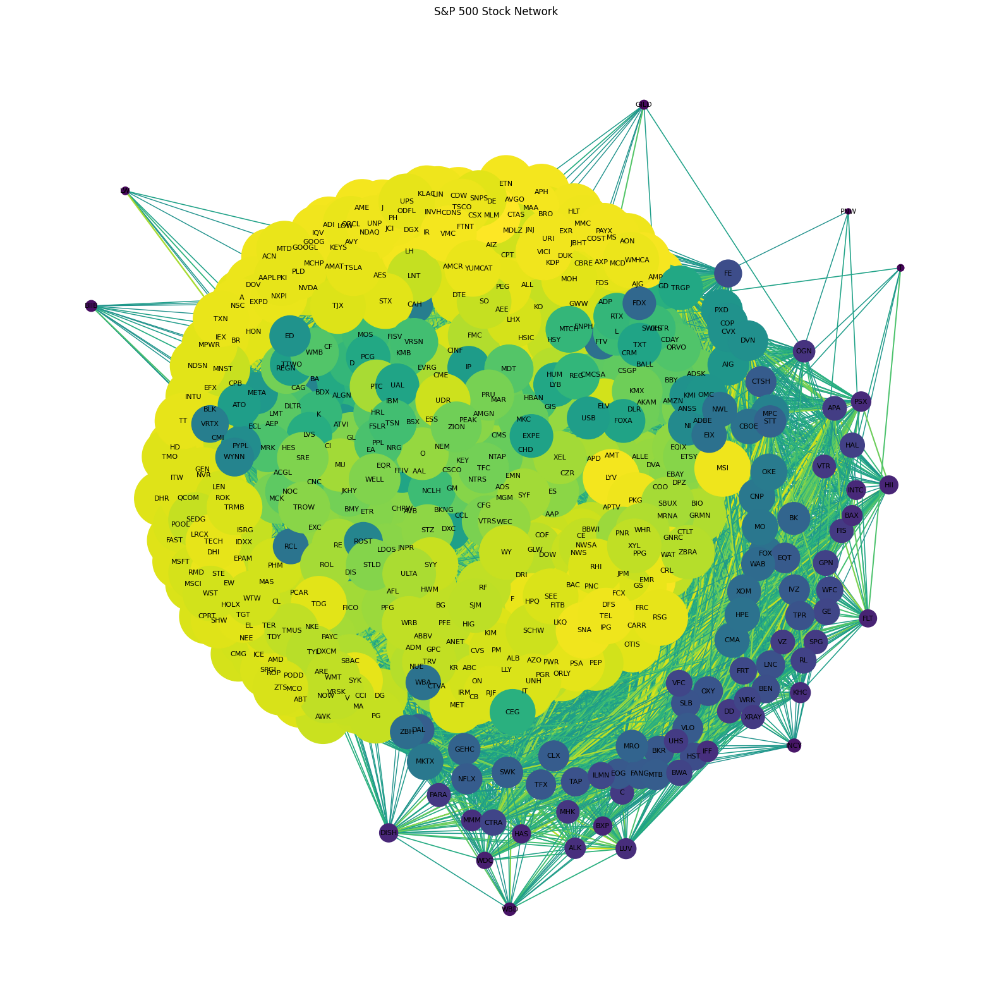

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import yfinance as yf

# Calculate the correlation matrix
df_close = df.pivot_table(index='Date', columns='Symbol', values='Close')
correlation_matrix = df_close.corr()

# Create an edge list from the correlation matrix
threshold = 0.5  # Adjust the threshold to filter out weak correlations
edges = []
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], abs(correlation_matrix.iloc[i, j])))

# Create a graph object and add edges
G = nx.Graph()
G.add_weighted_edges_from(edges)

# Set up the layout
pos = nx.kamada_kawai_layout(G)

# Set up node and edge colors
node_colors = [plt.cm.viridis(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes]
edge_colors = [plt.cm.viridis(edge_data['weight']) for _, _, edge_data in G.edges(data=True)]

# Set up node sizes (optional)
node_sizes = [G.degree[node] * 10 for node in G.nodes]

# Set up edge widths (optional)
edge_widths = [abs(edge_data['weight']) * 2 for _, _, edge_data in G.edges(data=True)]

# Draw the graph
plt.figure(figsize=(20, 20))
nx.draw_networkx(G, pos, node_size=node_sizes, node_color=node_colors, edge_color=edge_colors, width=edge_widths, with_labels=True, font_size=8)

# Set the plot title and display it
plt.title('S&P 500 Stock Network')
plt.axis('off')
plt.show()


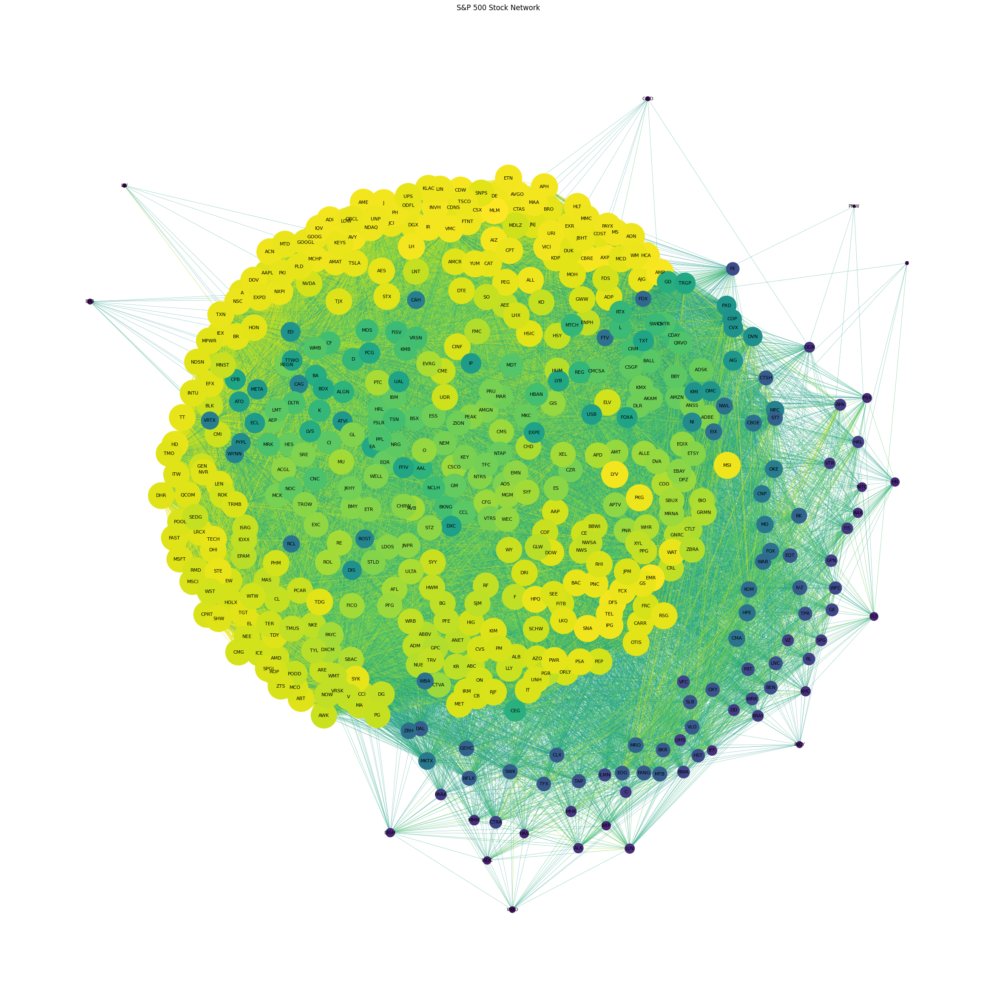

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import yfinance as yf

# Calculate the correlation matrix
df_close = df.pivot_table(index='Date', columns='Symbol', values='Close')
correlation_matrix = df_close.corr()

# Create an edge list from the correlation matrix
threshold = 0.5  # Adjust the threshold to filter out weak correlations
edges = []
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], abs(correlation_matrix.iloc[i, j])))

# Create a graph object and add edges
G = nx.Graph()
G.add_weighted_edges_from(edges)

# Set up the layout
pos = nx.kamada_kawai_layout(G)

# Set up node and edge colors
node_colors = [plt.cm.viridis(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes]
edge_colors = [plt.cm.viridis(edge_data['weight']) for _, _, edge_data in G.edges(data=True)]

# Set up node sizes (optional)
node_sizes = [G.degree[node] * 5 for node in G.nodes]

# Set up edge widths (optional)
edge_widths = [abs(edge_data['weight']) * 0.5 for _, _, edge_data in G.edges(data=True)]

# Draw the graph
plt.figure(figsize=(30, 30))
nx.draw_networkx(G, pos, node_size=node_sizes, node_color=node_colors, edge_color=edge_colors, width=edge_widths, with_labels=True, font_size=8)

# Set the plot title and display it
plt.title('S&P 500 Stock Network')
plt.axis('off')
plt.show()

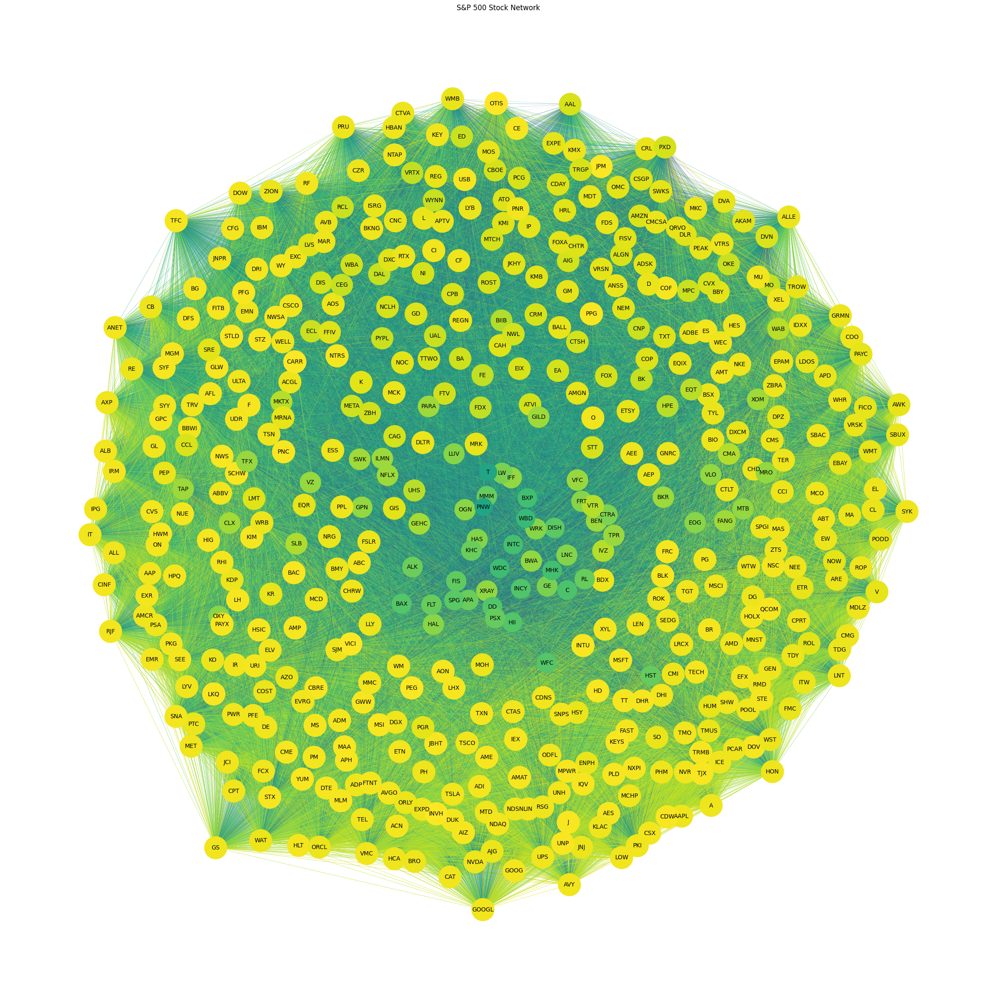

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import yfinance as yf

# Calculate the correlation matrix
df_close = df.pivot_table(index='Date', columns='Symbol', values='Close')
correlation_matrix = df_close.corr()

# Create an edge list from the correlation matrix
threshold = 0.1  # Adjust the threshold to filter out weak correlations
edges = []
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], abs(correlation_matrix.iloc[i, j])))

# Create a graph object and add edges
G = nx.Graph()
G.add_weighted_edges_from(edges)

# Set up the layout
pos = nx.kamada_kawai_layout(G)

# Set up node and edge colors
node_colors = [plt.cm.viridis(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes]
edge_colors = [plt.cm.viridis(edge_data['weight']) for _, _, edge_data in G.edges(data=True)]

# Set up node sizes (optional)
node_sizes = [G.degree[node] * 3 for node in G.nodes]

# Set up edge widths (optional)
edge_widths = [abs(edge_data['weight']) * 0.5 for _, _, edge_data in G.edges(data=True)]

# Draw the graph
plt.figure(figsize=(30, 30))
nx.draw_networkx(G, pos, node_size=node_sizes, node_color=node_colors, edge_color=edge_colors, width=edge_widths, with_labels=True, font_size=10)

# Set the plot title and display it
plt.title('S&P 500 Stock Network')
plt.axis('off')
plt.show()


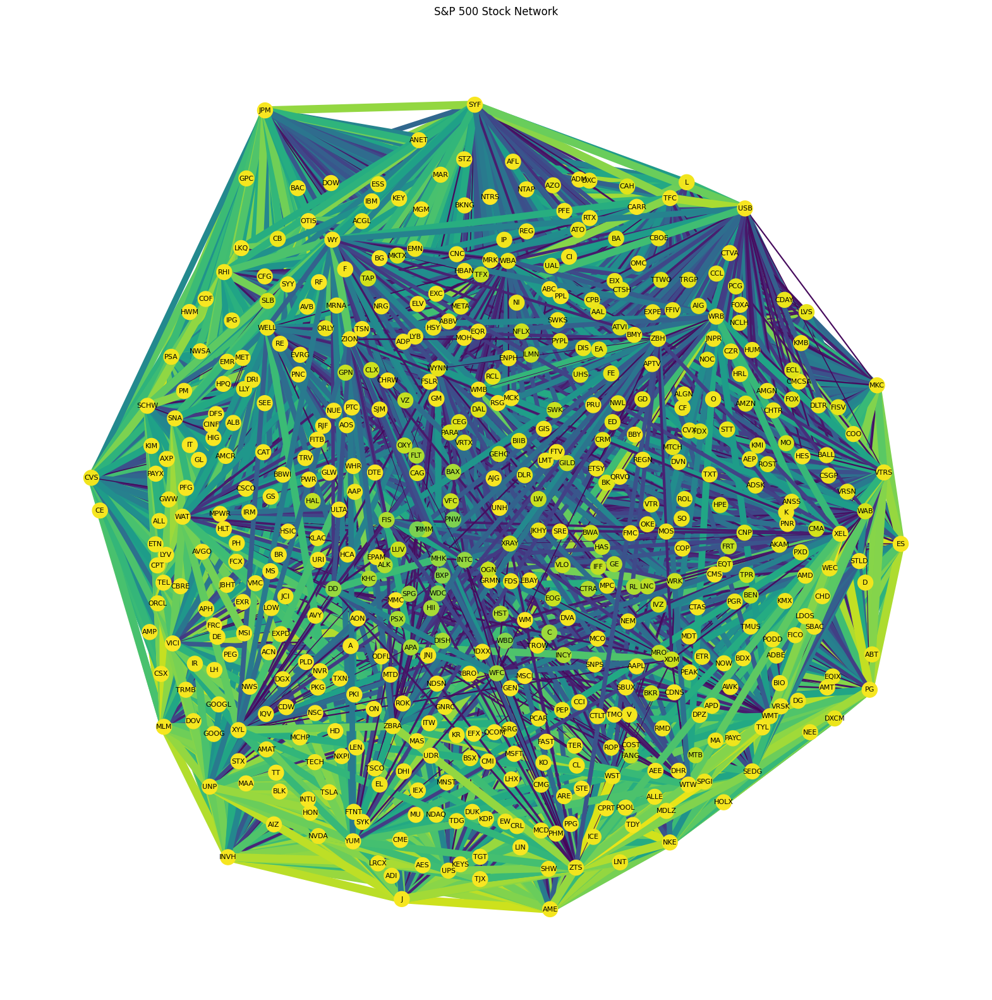

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import yfinance as yf

# Calculate the correlation matrix
df_close = df.pivot_table(index='Date', columns='Symbol', values='Close')
correlation_matrix = df_close.corr()

# Create an edge list from the correlation matrix
threshold = 0.05  # Adjust the threshold to filter out weak correlations
edges = []
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], abs(correlation_matrix.iloc[i, j])))

# Create a graph object and add edges
G = nx.Graph()
G.add_weighted_edges_from(edges)

# Set up the layout
pos = nx.kamada_kawai_layout(G)

# Set up node colors
node_colors = [plt.cm.viridis(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes]

# Set up edge colors and widths based on correlation strength
edge_colors = [plt.cm.viridis(abs(edge_data['weight']) ** 2) for _, _, edge_data in G.edges(data=True)]
edge_widths = [abs(edge_data['weight']) * 10 for _, _, edge_data in G.edges(data=True)]

# Draw the graph
plt.figure(figsize=(20, 20))
nx.draw_networkx(G, pos, node_color=node_colors, edge_color=edge_colors, width=edge_widths, with_labels=True, font_size=8)

# Set the plot title and display it
plt.title('S&P 500 Stock Network')
plt.axis('off')
plt.show()

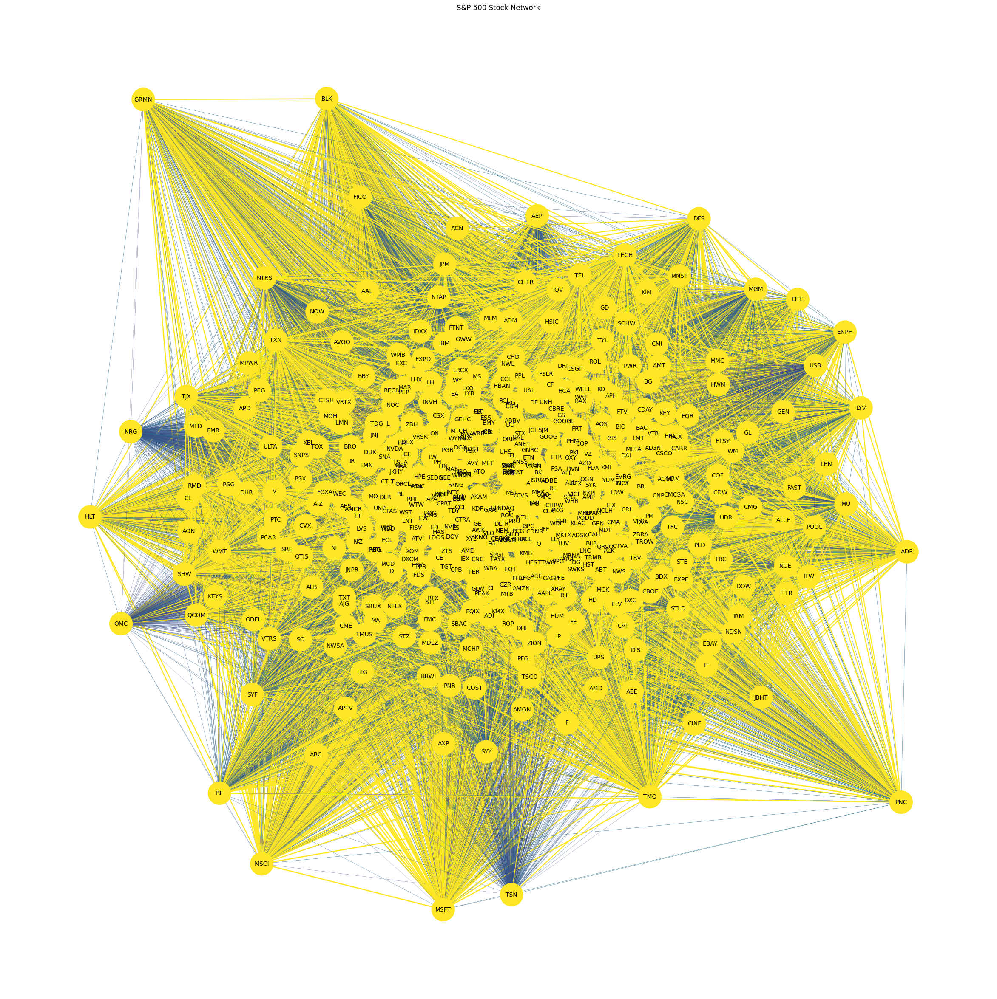

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import yfinance as yf

# Calculate the correlation matrix
df_close = df.pivot_table(index='Date', columns='Symbol', values='Close')
correlation_matrix = df_close.corr()

# Create an edge list from the correlation matrix
threshold = 0.8  # Adjust the threshold to filter out weak correlations
edges = []
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        weight = abs(correlation_matrix.iloc[i, j])
        if weight > threshold:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], 2 * weight))
        else:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], 0.5 * weight))

# Create a graph object and add edges
G = nx.Graph()
G.add_weighted_edges_from(edges)

# Set up the layout
pos = nx.kamada_kawai_layout(G)

# Set up node and edge colors
node_colors = [plt.cm.viridis(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes]
edge_colors = [plt.cm.viridis(edge_data['weight']) for _, _, edge_data in G.edges(data=True)]

# Set up node sizes (optional)
node_sizes = [G.degree[node] * 3 for node in G.nodes]

# Set up edge widths (optional)
edge_widths = [edge_data['weight'] for _, _, edge_data in G.edges(data=True)]

# Draw the graph
plt.figure(figsize=(30, 30))
nx.draw_networkx(G, pos, node_size=node_sizes, node_color=node_colors, edge_color=edge_colors, width=edge_widths, with_labels=True, font_size=10)

# Set the plot title and display it
plt.title('S&P 500 Stock Network')
plt.axis('off')
plt.show()


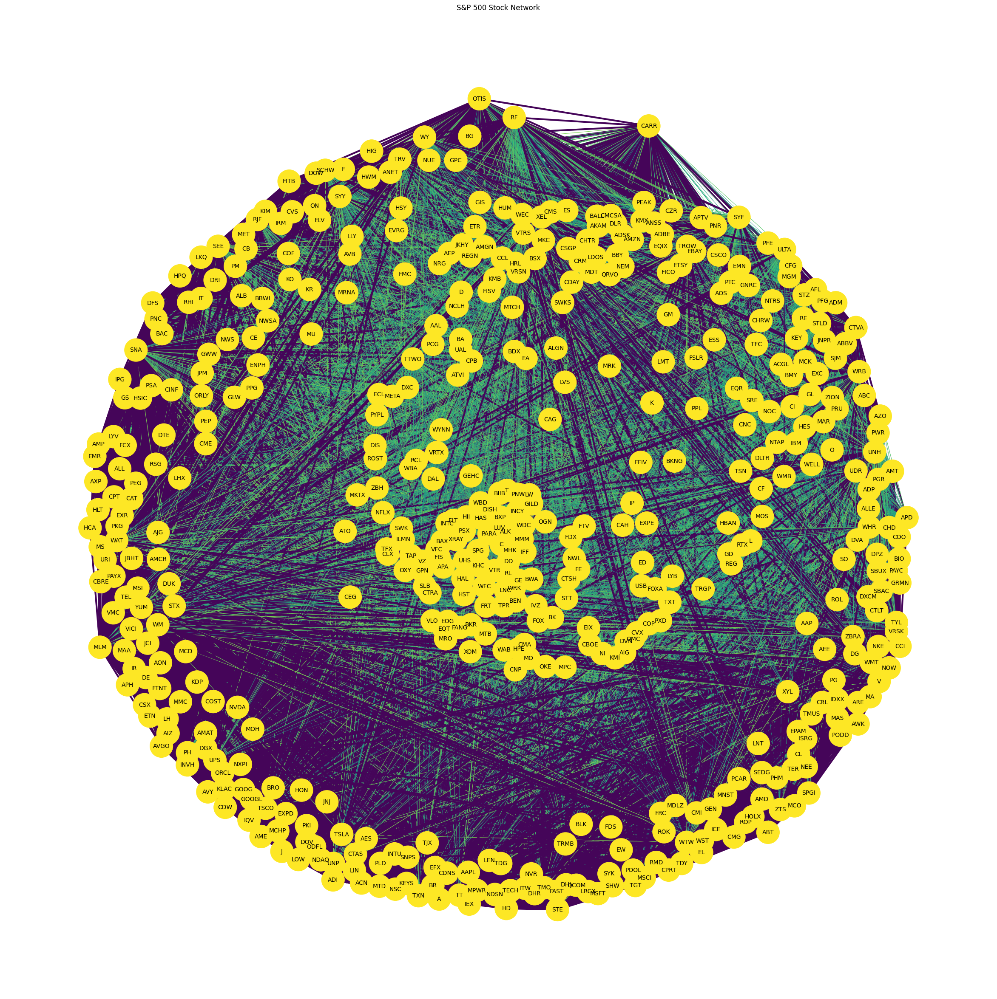

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import yfinance as yf

# Calculate the correlation matrix
df_close = df.pivot_table(index='Date', columns='Symbol', values='Close')
correlation_matrix = df_close.corr()

# Create an edge list from the correlation matrix
threshold_strong = 0.8  # Adjust the threshold to filter out weak correlations
threshold_weak = 0.5
edges = []
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        weight = abs(correlation_matrix.iloc[i, j])
        if weight > threshold_strong:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], 3))
        elif weight < threshold_weak:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], 0.1))
        else:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], weight))

# Create a graph object and add edges
G = nx.Graph()
G.add_weighted_edges_from(edges)

# Set up the layout
pos = nx.kamada_kawai_layout(G)

# Set up node and edge colors
node_colors = [plt.cm.viridis(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes]
edge_colors = [plt.cm.viridis(edge_data['weight']) for _, _, edge_data in G.edges(data=True)]

# Set up node sizes (optional)
node_sizes = [G.degree[node] * 3 for node in G.nodes]

# Set up edge widths (optional)
edge_widths = [edge_data['weight'] for _, _, edge_data in G.edges(data=True)]

# Draw the graph
plt.figure(figsize=(30, 30))
nx.draw_networkx(G, pos, node_size=node_sizes, node_color=node_colors, edge_color=edge_colors, width=edge_widths, with_labels=True, font_size=10)

# Set the plot title and display it
plt.title('S&P 500 Stock Network')
plt.axis('off')
plt.show()


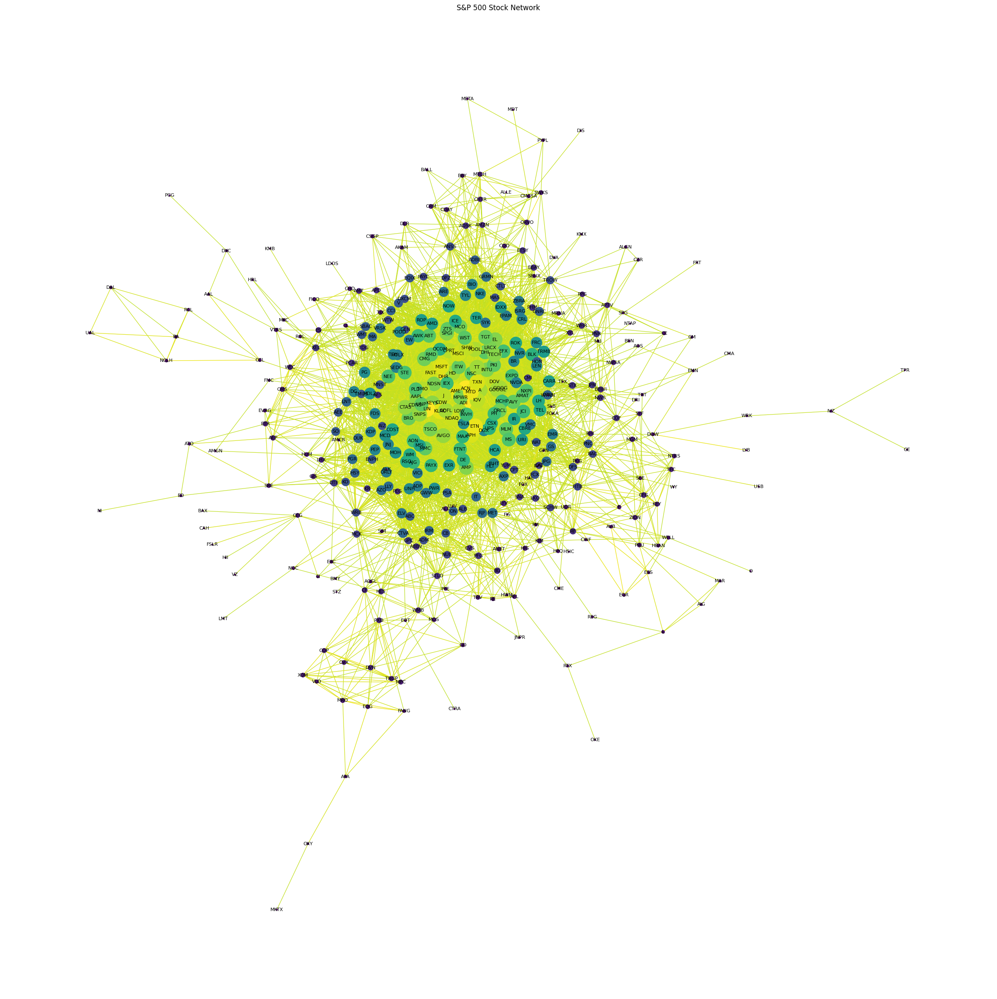

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import yfinance as yf

# Calculate the correlation matrix
df_close = df.pivot_table(index='Date', columns='Symbol', values='Close')
correlation_matrix = df_close.corr()

# Create an edge list from the correlation matrix
threshold = 0.9  # Adjust the threshold to filter out weak correlations
edges = []
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            edges.append((correlation_matrix.index[i], correlation_matrix.columns[j], abs(correlation_matrix.iloc[i, j])))

# Create a graph object and add edges
G = nx.Graph()
G.add_weighted_edges_from(edges)

# Set up the layout
pos = nx.kamada_kawai_layout(G)

# Set up node and edge colors
node_colors = [plt.cm.viridis(G.degree(node) / max(dict(G.degree()).values())) for node in G.nodes]
edge_colors = [plt.cm.viridis(edge_data['weight']) for _, _, edge_data in G.edges(data=True)]

# Set up node sizes (optional)
node_sizes = [G.degree[node] * 5 for node in G.nodes]

# Set up edge widths (optional)
edge_widths = [abs(edge_data['weight']) * 1 for _, _, edge_data in G.edges(data=True)]

# Draw the graph
plt.figure(figsize=(30, 30))
nx.draw_networkx(G, pos, node_size=node_sizes, node_color=node_colors, edge_color=edge_colors, width=edge_widths, with_labels=True, font_size=8)

# Set the plot title and display it
plt.title('S&P 500 Stock Network')
plt.axis('off')
plt.show()